In [1]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from tensorflow.keras import models, optimizers
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from datetime import datetime as dt
from sklearn.model_selection import KFold
import import_ipynb
from Model_dev import compress_to_2d, get_model, LSTM_model, Attention, C_LSTM, data_handling, model_development, rmse, draw_graph
import copy

importing Jupyter notebook from Model_dev.ipynb


In [2]:
country = 'United States'
datadir = os.path.join(os.getcwd(), "Data")
modeldir = os.path.join(os.getcwd(), "Models")
logdir = os.path.join(os.getcwd(), "Log")
filename = "Full_{}.csv".format(country)
filepath = os.path.join(datadir, filename)
social_media = ['like_index','retweet_index']
covid_cases = ['ConfirmedCases', 'ConfirmedDeaths', 'Daily_cases']
general_info = ['CountryCode_x', 'CountryName_x', 'Jurisdiction', 'Date']
num_variable = ['E3_Fiscal measures', 'E4_International support', 'H5_Investment in vaccines', 'H4_Emergency investment in healthcare']
required_days = 14
pred_days = 7

In [3]:
from numpy.random import seed
seed(1234)
from tensorflow.random import set_seed
set_seed(1234)

In [4]:
if not os.path.isdir(modeldir):
    os.mkdir(modeldir)
if not os.path.isdir(logdir):
    os.mkdir(logdir)
if not os.path.isdir(datadir):
    os.mkdir(datadir)
if not os.path.isdir(os.path.join(logdir, country)):
    os.mkdir(os.path.join(logdir, country))

In [5]:
df = pd.read_csv(filepath, index_col=0)
df.set_index('Date', inplace=True)

policy = []
columns = df.columns
for column in columns:
    if not any(column in _list for _list in [social_media, general_info, covid_cases]):
        policy.append(column)
categorical_variable = list(set(policy) - set(num_variable))
df[categorical_variable] = df[categorical_variable].astype("category")

##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)
##### Model Development #####
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 32)                7296      
_________________________________________________________________
dense (Dense)                (None, 32)                1056      
_________________________________________________________________
dense_1 (Dense)              (None, 7)                 231       
_________________________________________________________________
reshape (Reshape)            (None, 7, 1)              0         
Total params: 8,583
Trainable params: 8,583
Non-trainable params: 0
_________________________________________________________________
Model: "model"
__________________________________________________________________________________________________
Layer (type)    

INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-07Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-07Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-07C-LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-07C-LSTM\assets


##### Log completed #####


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

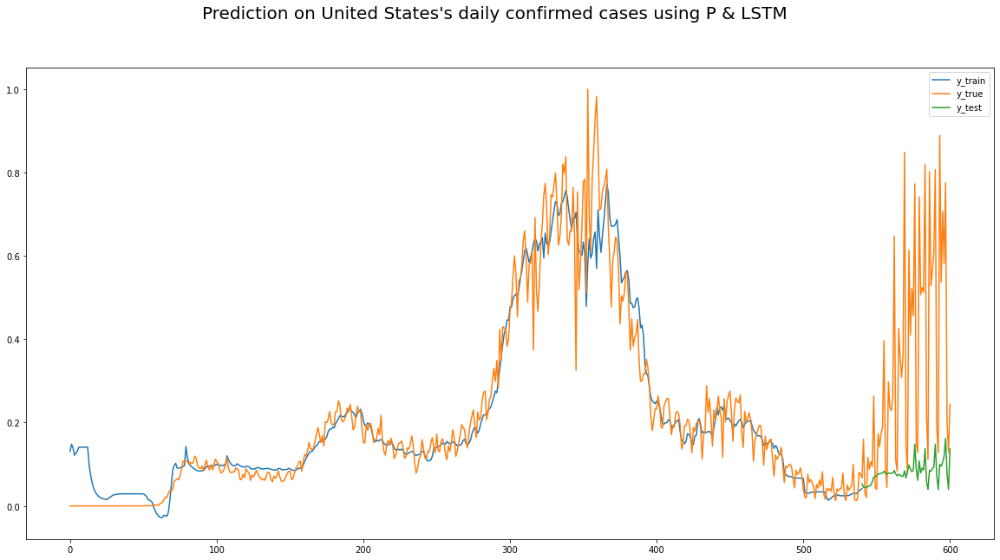

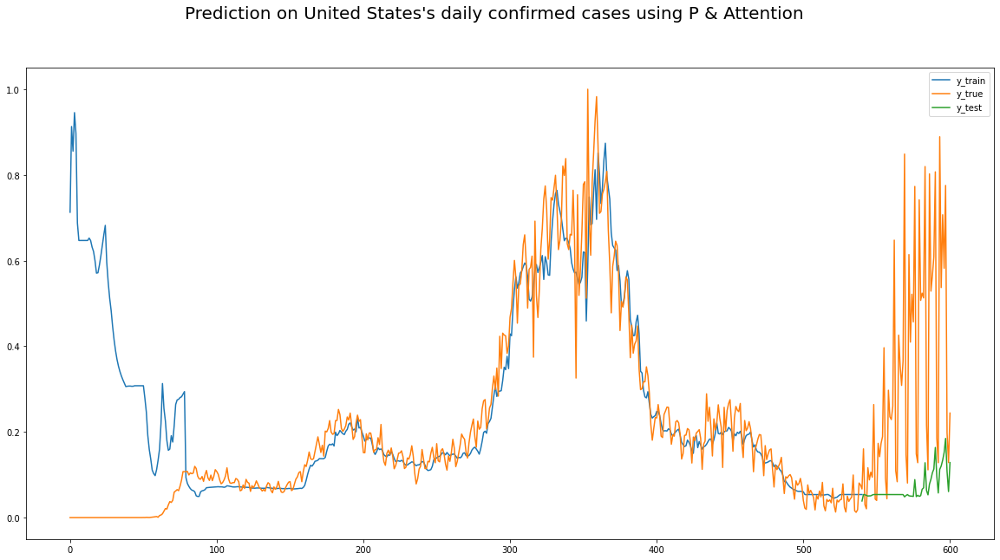

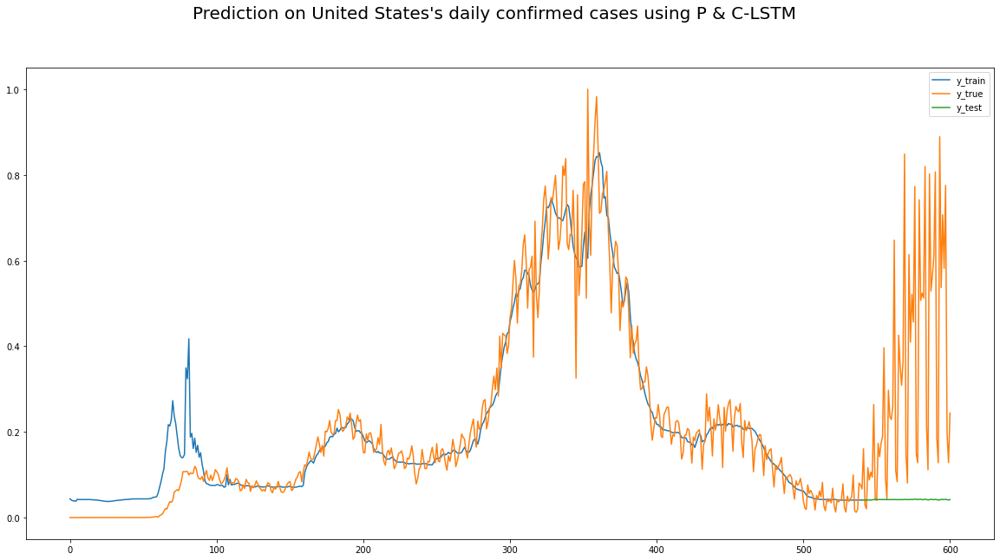

In [6]:
features = policy
x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
model_development(x_train, x_test, y_train, y_test, "P", country, modeldir, logdir, required_days, pred_days)

##### Reshape and MinMaxScale input #####
(535, 14, 26) (535, 7, 1) (60, 14, 26) (60, 7, 1)
##### Model Development #####
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_5 (LSTM)                (None, 32)                7552      
_________________________________________________________________
dense_6 (Dense)              (None, 32)                1056      
_________________________________________________________________
dense_7 (Dense)              (None, 7)                 231       
_________________________________________________________________
reshape_3 (Reshape)          (None, 7, 1)              0         
Total params: 8,839
Trainable params: 8,839
Non-trainable params: 0
_________________________________________________________________
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)

INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-26LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-26Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-26Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-26C-LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-26C-LSTM\assets


##### Log completed #####


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

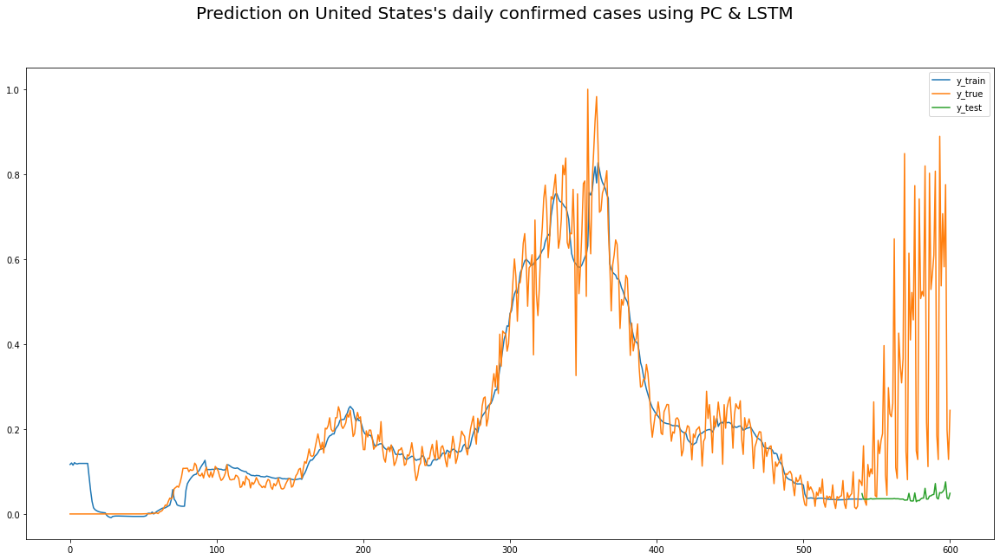

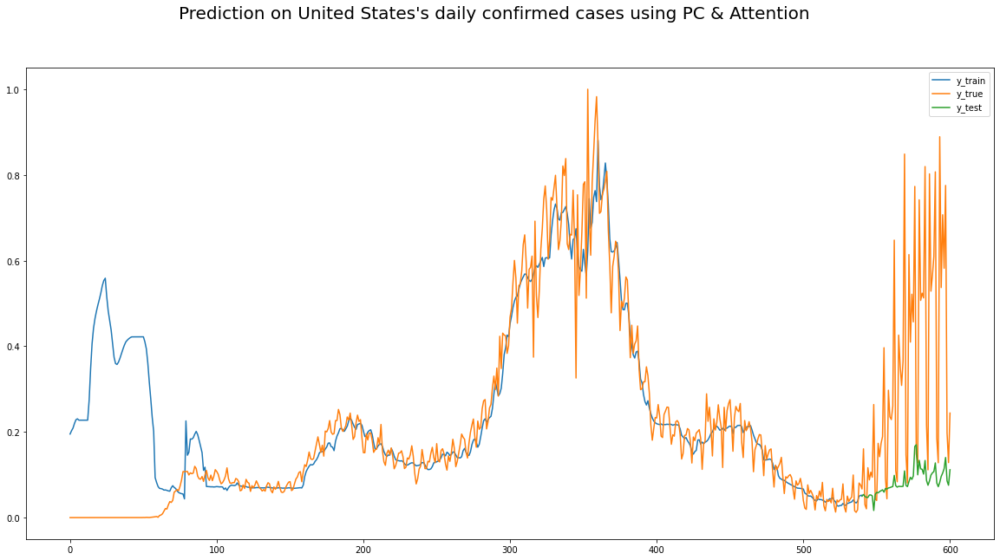

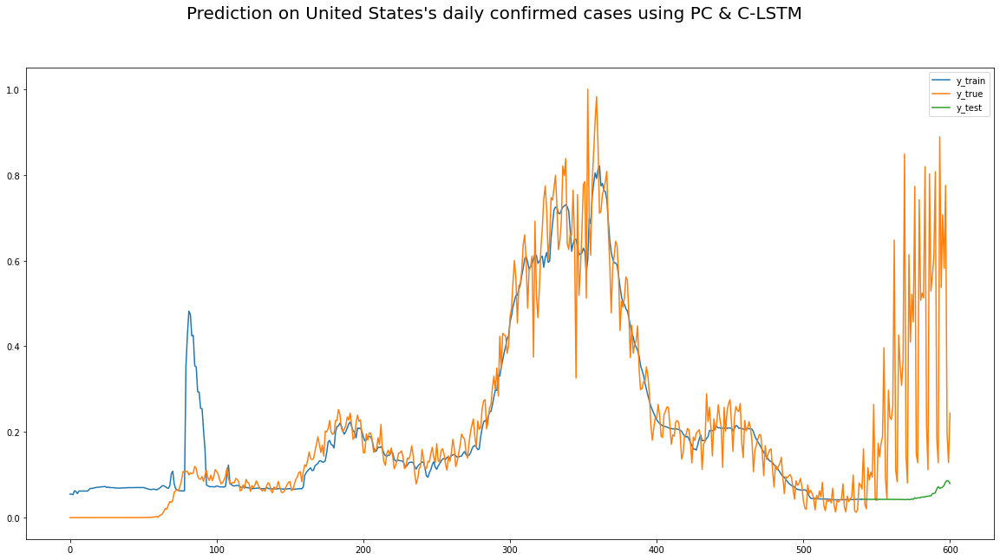

In [7]:
features = policy + covid_cases
x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
model_development(x_train, x_test, y_train, y_test, "PC", country, modeldir, logdir, required_days, pred_days)

##### Reshape and MinMaxScale input #####
(535, 14, 28) (535, 7, 1) (60, 14, 28) (60, 7, 1)
##### Model Development #####
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_10 (LSTM)               (None, 32)                7808      
_________________________________________________________________
dense_12 (Dense)             (None, 32)                1056      
_________________________________________________________________
dense_13 (Dense)             (None, 7)                 231       
_________________________________________________________________
reshape_6 (Reshape)          (None, 7, 1)              0         
Total params: 9,095
Trainable params: 9,095
Non-trainable params: 0
_________________________________________________________________
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)

INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-45LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-45Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-45Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-45C-LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211028 20-45C-LSTM\assets


##### Log completed #####


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

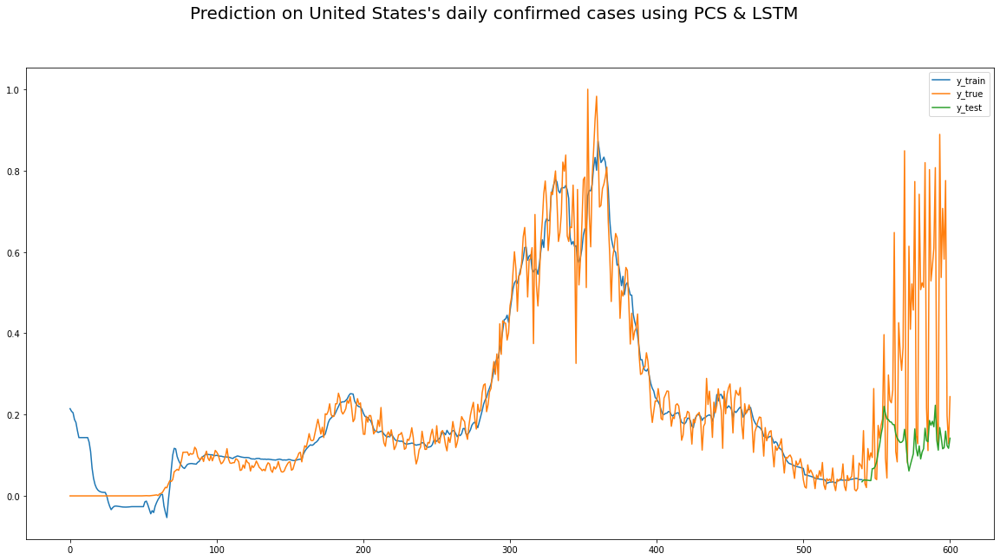

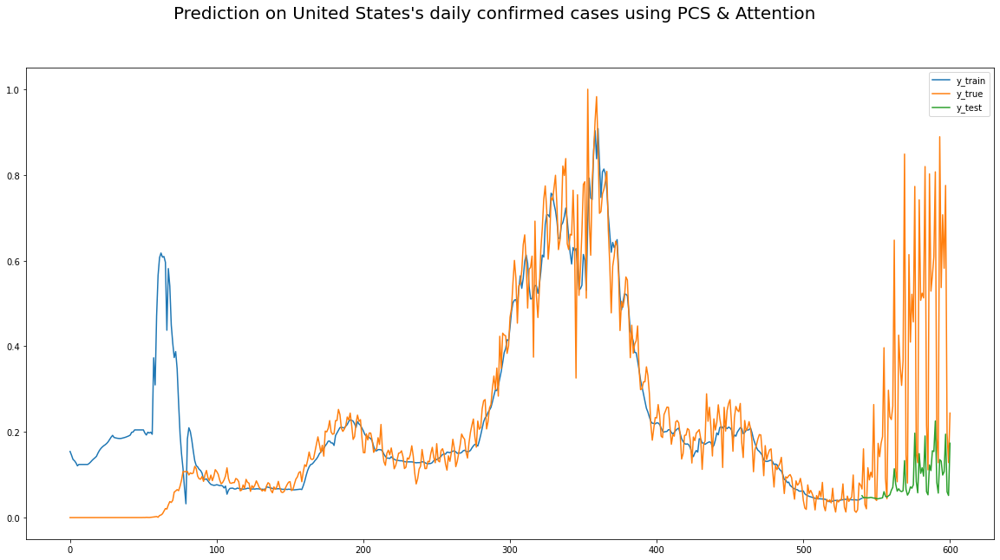

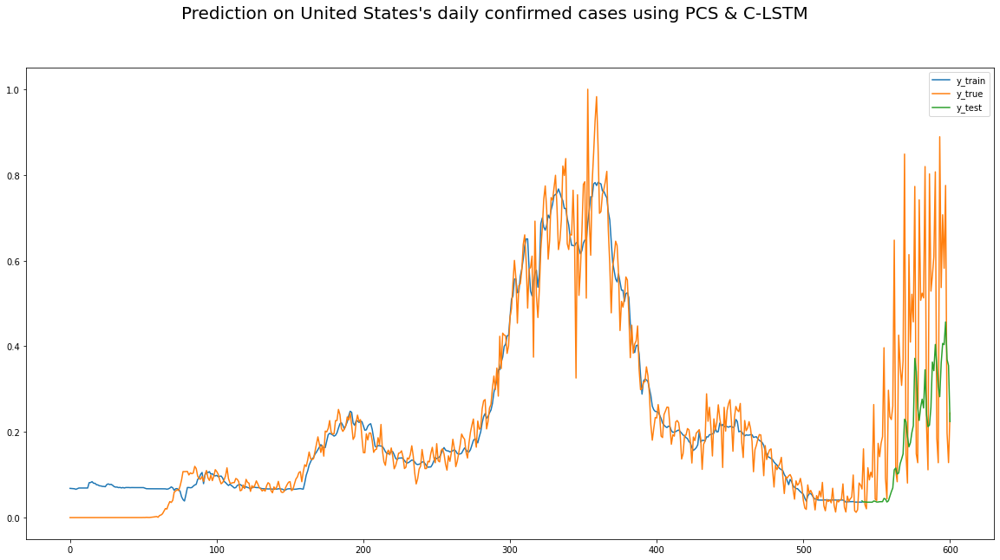

In [8]:
features = policy + covid_cases + social_media
x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
model_development(x_train, x_test, y_train, y_test, "PCS", country, modeldir, logdir, required_days, pred_days)

In [9]:
### Best model for the country
log_file = os.path.join(logdir,"Models.csv")
best_result = get_model(log_file, country)

features_used = best_result['Features'].values[0]
algo = best_result['Algorithm'].values[0]
best_model_filepath = best_result['Model_path'].values[0]
best_model = models.load_model(best_model_filepath, custom_objects={'rmse':rmse})
config = best_model.get_config()

if features_used == "P":
    features = policy
elif features_used == "PC":
    features = policy + covid_cases
else:
    features = policy + covid_cases + social_media

x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
y_pred_train = compress_to_2d(best_model.predict(x_train))
y_pred_test = compress_to_2d(best_model.predict(x_test))
y_true_train = compress_to_2d(y_train)
y_true_test = compress_to_2d(y_test)

mse = tf.keras.losses.MeanSquaredError()
loss = mse(y_true_train, y_pred_train).numpy()
val_loss = mse(y_true_test, y_pred_test).numpy()

##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


In [10]:
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=100, mode='min')
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=10, factor=0.4, min=0.00001)
opt = optimizers.Adam(learning_rate=0.01)

##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.002790806582197547
Changes in Validation loss: 0.003035474568605423
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.029802711680531502
Changes in Validation loss: 0.0006229449063539505
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.0034994042944163084
Changes in Validation loss: 0.0018757954239845276
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.0016196358483284712
Changes in Validation loss: 0.005985161289572716
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.004112614318728447
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.0070772795006632805
Changes in Validation loss: 0.0006881877779960632
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.010734730400145054
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 0.000927105313166976
Changes in Validation loss: -1.0728836059570312e-06
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.0025845009367913008
Changes in Validation loss: 0.004648536443710327
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.001479387516155839
Changes in Validation loss: 0.00033717788755893707
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: 0.0021697029005736113
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 1.4197314158082008e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.004186405800282955
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 0.004183498211205006
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.004031398333609104
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: -4.5157503336668015e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 1.3616401702165604e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: 0.0005102735012769699
Changes in Validation loss: 0.002651005983352661
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.004662386141717434
Changes in Validation loss: 0.014086414128541946
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 0.005547930486500263
Changes in Validation loss: 0.0008529573678970337
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value
C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.002029071794822812
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0010221772827208042
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(535, 14, 24) (535, 7, 1) (60, 14, 24) (60, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0036076733376830816
Changes in Validation loss: 0.0


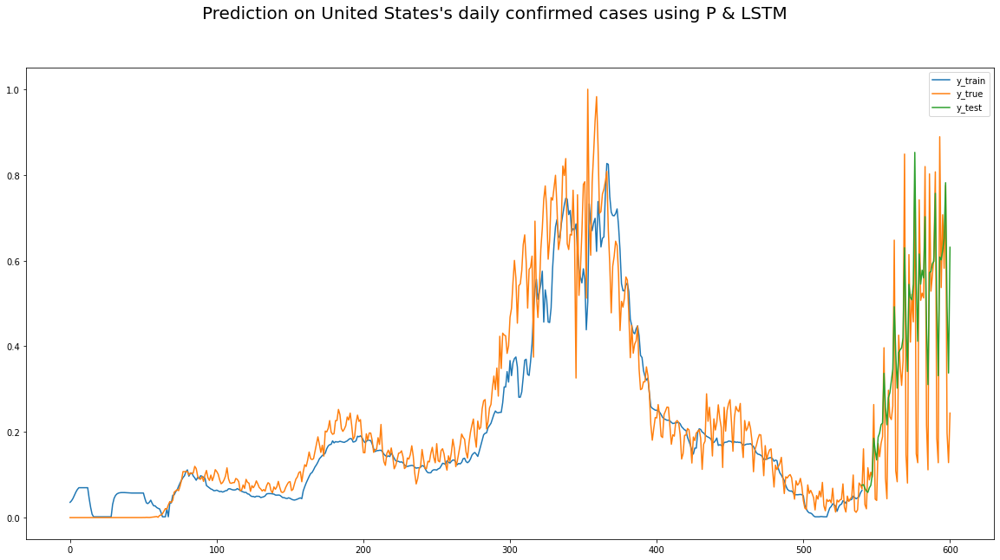

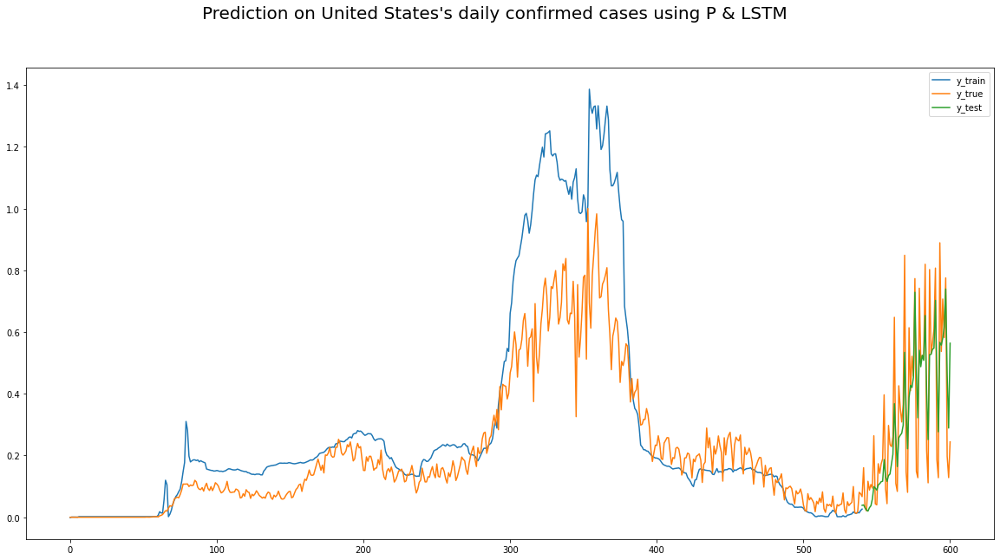

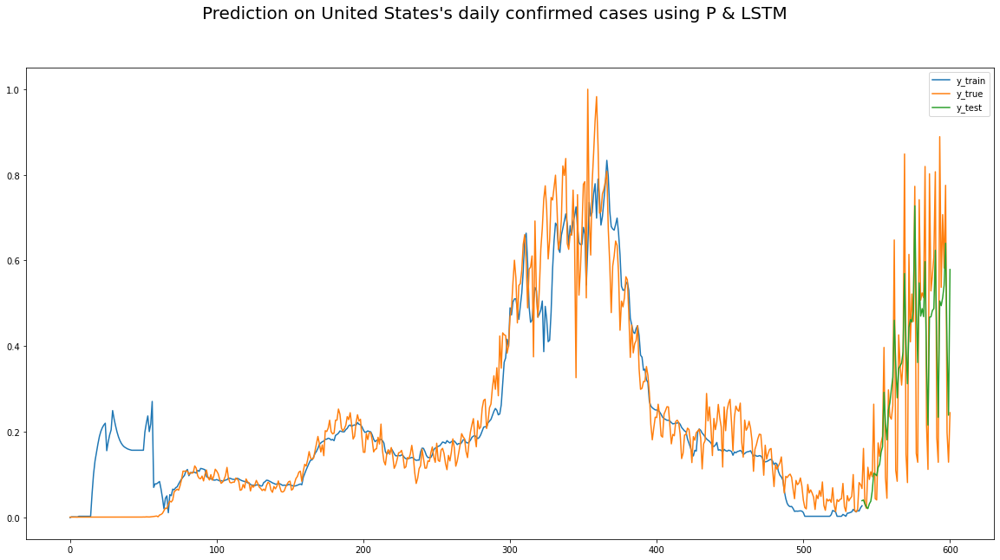

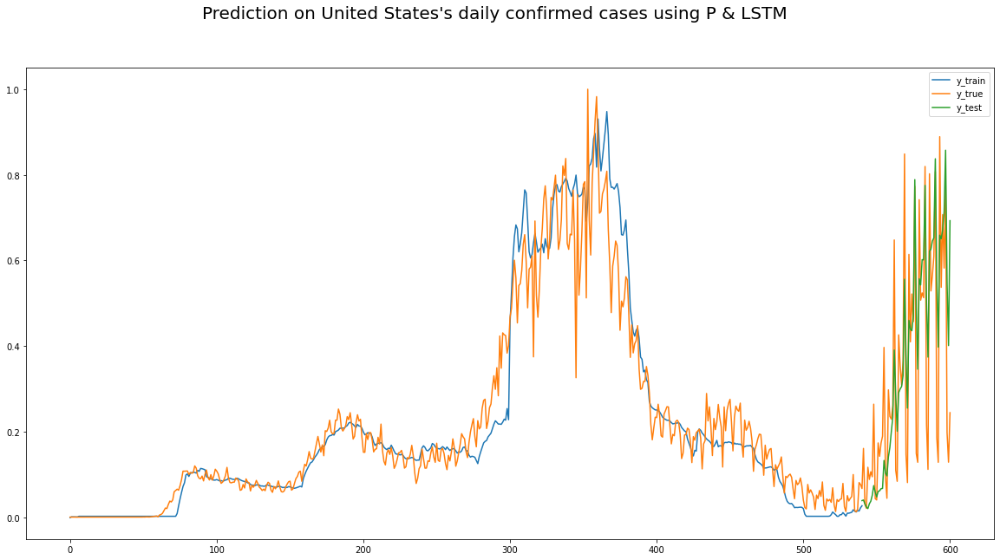

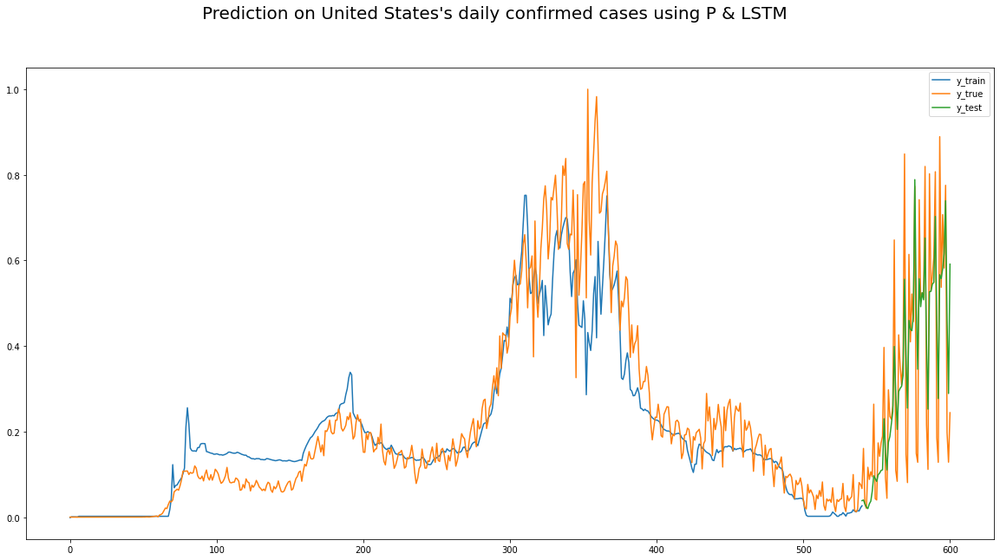

...

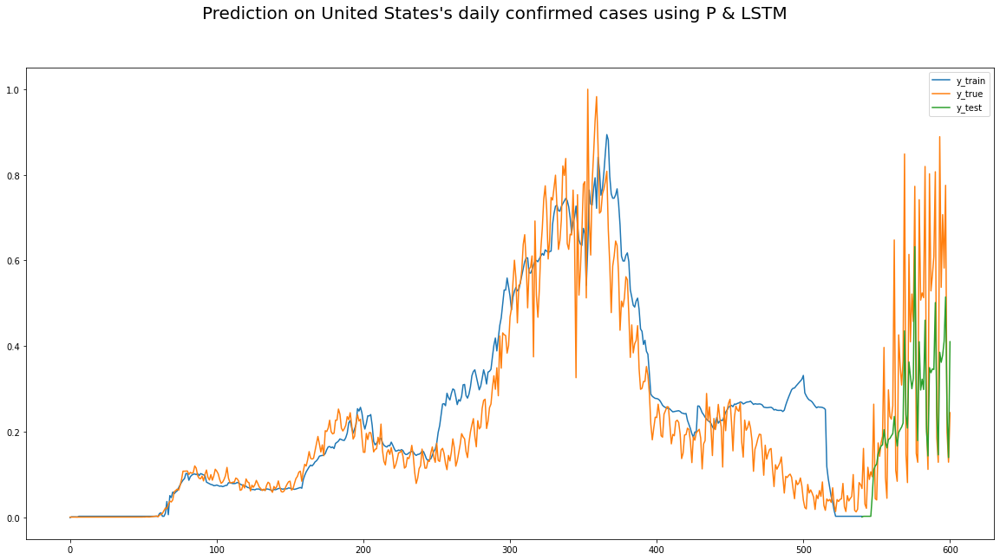

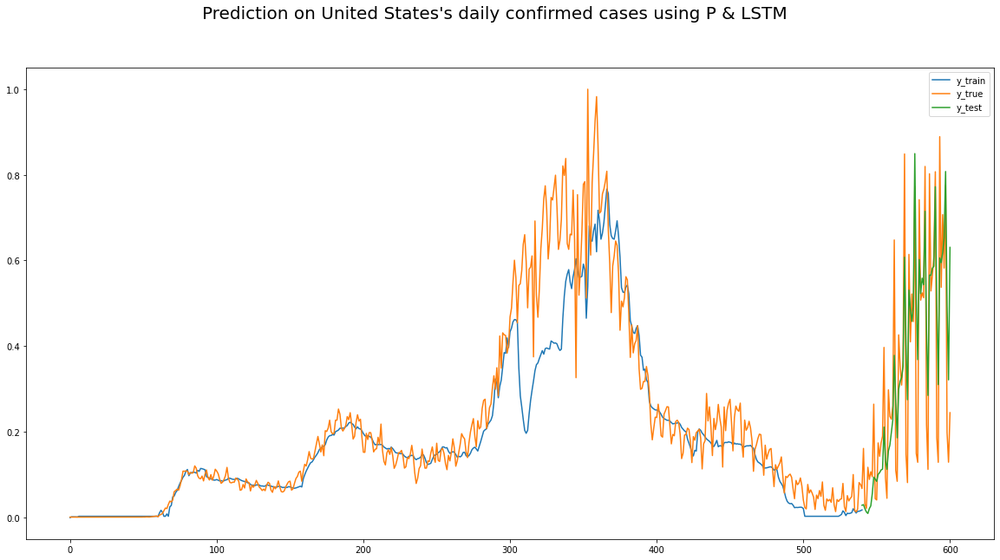

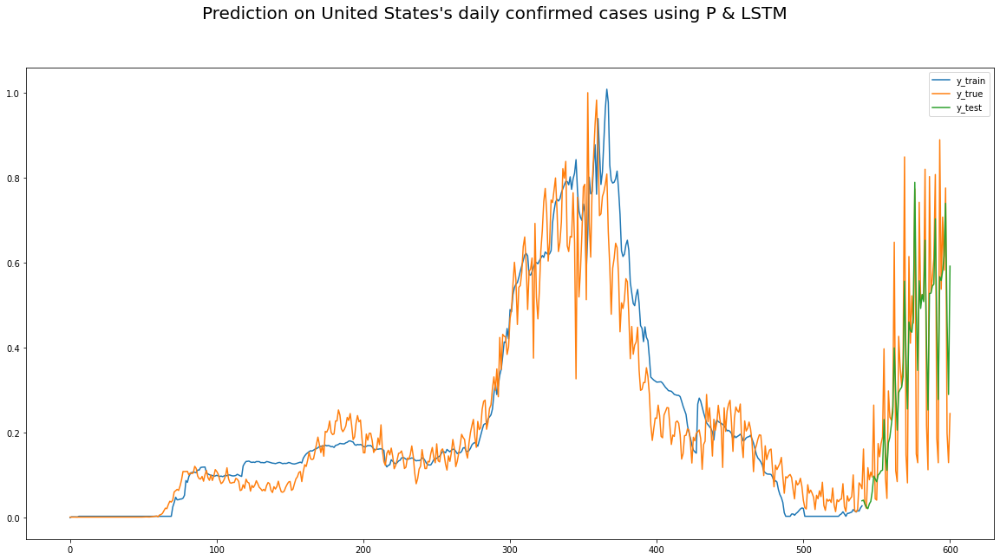

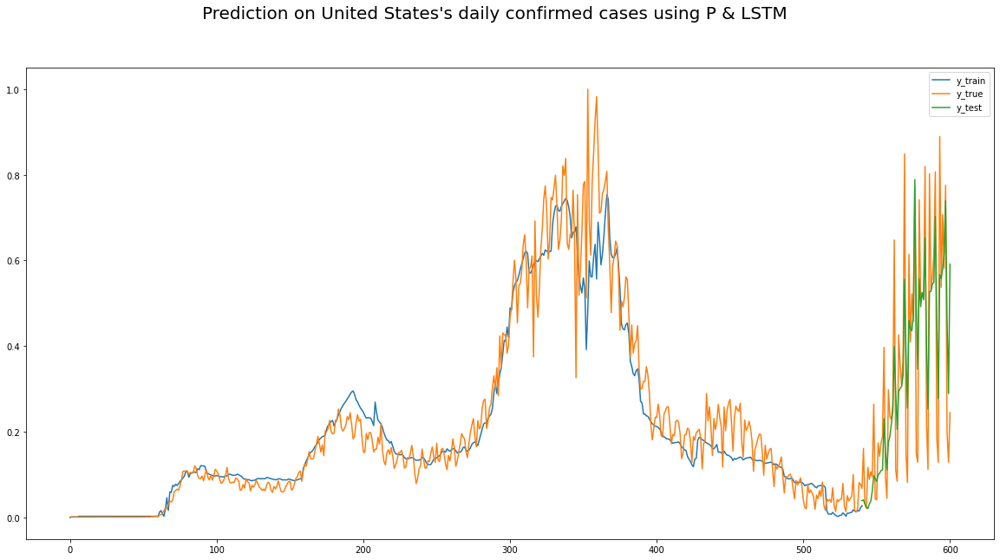

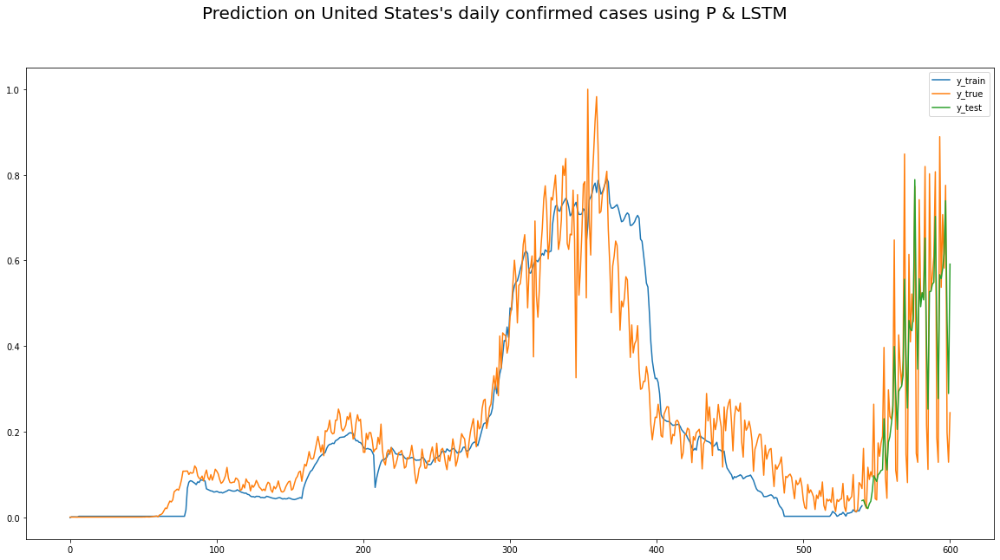

In [11]:
### Feature importance for the country
result = {}

for i in range(len(policy)):
    
    target = policy[i]
    x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days, swap_col=target)
    
    exp_train = compress_to_2d(best_model.predict(x_train))
    exp_test = compress_to_2d(best_model.predict(x_test))
    
    draw_graph(exp_train, exp_test, y_true_train, y_true_test, required_days, pred_days, country, features_used, x_train, algo)
    
    _loss = mse(y_true_train, exp_train).numpy()
    _val_loss = mse(y_true_test, exp_test).numpy()
    
    print("######", target, "#####")
    print("Changes in loss: {}".format(_loss-loss))
    print("Changes in Validation loss: {}".format(_val_loss-val_loss))
    
    result[target] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]

Changes = pd.DataFrame.from_dict(result, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
Changes.to_csv(os.path.join(logdir, "{}/{}_feat_importance.csv".format(country, country)))

##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### Jan #####
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.0006672991439700127
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.008785669691860676
Changes in Validation loss: 0.03149166703224182
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.003697554813697934
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.04692671820521355
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.0013015293516218662
Changes in Validation loss: 0.007181376218795776
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.002033627824857831
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.0026516986545175314
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: -1.6023404896259308e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.00312360399402678
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.0018245375249534845
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: 8.946540765464306e-05
Changes in Validation loss: 0.011398330330848694
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 4.969770088791847e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.00048227375373244286
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: -4.521268419921398e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.017150940373539925
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: 1.8759164959192276e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 4.2549800127744675e-06
Changes in Validation loss: -0.0007076114416122437
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.004545486532151699
Changes in Validation loss: -0.00025866180658340454
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: -0.0007346442434936762
Changes in Validation loss: -0.020025599747896194
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: -3.997446037828922e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value
C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0003989539109170437
Changes in Validation loss: -0.03163265436887741
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0007879557088017464
Changes in Validation loss: 0.05019545555114746
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: -0.00043392740190029144
Changes in Validation loss: -0.01834317296743393
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### Feb #####
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.0007503095548599958
Changes in Validation loss: 4.963250830769539e-05
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.009664155542850494
Changes in Validation loss: -0.00035238685086369514
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.003450005082413554
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.03995653614401817
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.0029038155917078257
Changes in Validation loss: -0.0030841995030641556
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.0017892660107463598
Changes in Validation loss: -7.947208359837532e-05
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.0032099320087581873
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 2.3079337552189827e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.004620862193405628
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.0026393320877104998
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0008704776410013437
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 1.0926742106676102e-06
Changes in Validation loss: 1.1175870895385742e-08
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.00047104060649871826
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 3.447430208325386e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.010114625096321106
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: 1.2775184586644173e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: -5.282624624669552e-05
Changes in Validation loss: 0.0005685891956090927
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.004799065180122852
Changes in Validation loss: -0.00013646436855196953
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.0011108128819614649
Changes in Validation loss: 0.04022657498717308
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 4.370999522507191e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.003029867773875594
Changes in Validation loss: 0.024590210989117622
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.007814161479473114
Changes in Validation loss: 0.019491109997034073
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 2.1836021915078163e-05
Changes in Validation loss: 0.012605920433998108
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### March #####
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.0009460658766329288
Changes in Validation loss: -0.00010781711898744106
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.01250588521361351
Changes in Validation loss: -4.2405445128679276e-05
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.003290727734565735
Changes in Validation loss: -4.9557071179151535e-05
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.03302845358848572
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.0029815230518579483
Changes in Validation loss: 0.0016208994202315807
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.0014494070783257484
Changes in Validation loss: -0.0004709935747087002
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: 0.0038280771113932133
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 9.095296263694763e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.004609305411577225
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.004135860595852137
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0017550168558955193
Changes in Validation loss: 0.001363418996334076
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 4.212837666273117e-06
Changes in Validation loss: -8.847564458847046e-09
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.001047312282025814
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 4.3275533244013786e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.0069560580886900425
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: -1.5503494068980217e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 1.551513560116291e-05
Changes in Validation loss: -1.461012288928032e-06
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.004824293311685324
Changes in Validation loss: 1.4691613614559174e-07
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.0013383487239480019
Changes in Validation loss: 0.0076682958751916885
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: 0.00011173938401043415
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.001953426282852888
Changes in Validation loss: 0.0026490348391234875
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.001817899290472269
Changes in Validation loss: 0.0009125603828579187
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.003237207420170307
Changes in Validation loss: 0.0016123573295772076
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### April #####
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.001590411877259612
Changes in Validation loss: -0.0013527069240808487
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.016201797872781754
Changes in Validation loss: -3.066938370466232e-05
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.0030855468939989805
Changes in Validation loss: 0.0007248981855809689
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.02437533065676689
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.002806782489642501
Changes in Validation loss: -0.0033411819022148848
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.0005636701826006174
Changes in Validation loss: -0.004275311715900898
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.0068442681804299355
Changes in Validation loss: -0.00021028844639658928
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 9.0358080342412e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.004154267720878124
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.004706808365881443
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0004260109271854162
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 7.391907274723053e-06
Changes in Validation loss: -3.3527612686157227e-08
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.0037789212074130774
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 0.00012919935397803783
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.008757310919463634
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: 4.103942774236202e-05
Changes in Validation loss: -1.471489667892456e-07
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 2.0834850147366524e-05
Changes in Validation loss: 0.00012382306158542633
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.004813475534319878
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.0017732770647853613
Changes in Validation loss: 0.004249191842973232
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 8.34115780889988e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.003039368661120534
Changes in Validation loss: -0.0017626788467168808
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0012162246275693178
Changes in Validation loss: -0.0012458651326596737
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.003989223390817642
Changes in Validation loss: 0.017783481627702713
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### May #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: 0.002296878257766366
Changes in Validation loss: -0.001543114660307765
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.025267653167247772
Changes in Validation loss: -0.0007127160206437111
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.0029866036493331194
Changes in Validation loss: 0.00017095892690122128
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.017109043896198273
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.0036767551209777594
Changes in Validation loss: -0.001627700636163354
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.000814167084172368
Changes in Validation loss: -0.0009604725055396557
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.009594053030014038
Changes in Validation loss: -0.0010666052112355828
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 7.019517943263054e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.0038551955949515104
Changes in Validation loss: -0.0007970870938152075
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.004554389044642448
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0014443581458181143
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 6.800983101129532e-07
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.004560397006571293
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 0.00019477587193250656
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.011589623987674713
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: -1.0879943147301674e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 8.009374141693115e-06
Changes in Validation loss: -1.1546071618795395e-06
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.00431501679122448
Changes in Validation loss: -1.4584045857191086e-05
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.0007967108394950628
Changes in Validation loss: 0.029683029279112816
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 8.24849121272564e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.001951906131580472
Changes in Validation loss: 0.000677385600283742
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0009764016140252352
Changes in Validation loss: -0.0018724612891674042
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.004274487495422363
Changes in Validation loss: 0.006674708798527718
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### June #####
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.003524887142702937
Changes in Validation loss: -0.0007518538041040301
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.02527748979628086
Changes in Validation loss: -0.0004427561070770025
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.004001308232545853
Changes in Validation loss: 1.685391180217266e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.00821712426841259
Changes in Validation loss: -0.00028124661184847355
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.003798543242737651
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.0028635060880333185
Changes in Validation loss: -0.0015103816986083984
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.013082392513751984
Changes in Validation loss: -0.0013761911541223526
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 0.0004006254021078348
Changes in Validation loss: -7.40766990929842e-05
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.0029402633663266897
Changes in Validation loss: -0.0014422014355659485
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.0032456342596560717
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 5.382345989346504e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: -5.107838660478592e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.004565926268696785
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 0.0010705559980124235
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.021957069635391235
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: 5.063251592218876e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 6.967224180698395e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.002006867667660117
Changes in Validation loss: -0.0009128322126343846
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.0032647012267261744
Changes in Validation loss: 0.023433389142155647
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 0.0004923164378851652
Changes in Validation loss: 3.8573285564780235e-05
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.001993947895243764
Changes in Validation loss: 4.039076156914234e-05
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0012479478027671576
Changes in Validation loss: -0.0010905265808105469
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.00392533652484417
Changes in Validation loss: -1.741875894367695e-05
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### July #####
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.0030263299122452736
Changes in Validation loss: -0.00033290591090917587
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.026255987584590912
Changes in Validation loss: 0.0011534150689840317
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.003866960760205984
Changes in Validation loss: -0.0001320703886449337
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.0033157062716782093
Changes in Validation loss: -0.0012549185194075108
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.004165105056017637
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.005840879864990711
Changes in Validation loss: -0.00020803790539503098
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.012290824204683304
Changes in Validation loss: -1.2145377695560455e-05
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 0.00037802732549607754
Changes in Validation loss: -2.489471808075905e-05
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.0013794582337141037
Changes in Validation loss: -0.001035533845424652
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.0022830870002508163
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0020006773993372917
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: -4.2994506657123566e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.00490532536059618
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 0.0020646187476813793
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.018726471811532974
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: -2.134731039404869e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 2.5816261768341064e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.0011980324052274227
Changes in Validation loss: 0.0023940009996294975
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.00450251717120409
Changes in Validation loss: 0.0038663335144519806
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 0.0031480644829571247
Changes in Validation loss: 0.0007992377504706383
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0019446690566837788
Changes in Validation loss: -7.340684533119202e-06
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0010622839909046888
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.003667025826871395
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)
###### August #####
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.0029433679301291704
Changes in Validation loss: 0.004047932103276253
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.027547737583518028
Changes in Validation loss: 0.000681927427649498
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.0035207055043429136
Changes in Validation loss: 0.003713475540280342
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.001519327750429511
Changes in Validation loss: 0.003304818645119667
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.003909081220626831
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.006613215431571007
Changes in Validation loss: 0.0021065548062324524
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.010938952676951885
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 0.0007516681216657162
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.0022545696701854467
Changes in Validation loss: 0.004330357536673546
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.0015890274662524462
Changes in Validation loss: 0.0006181560456752777
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0021817947272211313
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 5.086883902549744e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.004103691317141056
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H2_Testing policy #####
Changes in loss: 0.003826962551102042
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.00469562504440546
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: -7.1569811552762985e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 1.3113021850585938e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.0007084095850586891
Changes in Validation loss: 0.004129176959395409
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.004575311206281185
Changes in Validation loss: 0.022599877789616585
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: 0.004952198825776577
Changes in Validation loss: -0.00061836838722229
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0019284451846033335
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0009660392533987761
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(559, 14, 24) (559, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.003455274971202016
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)
###### Sept #####
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C1_School closing #####
Changes in loss: 0.0026894928887486458
Changes in Validation loss: 0.001048114150762558
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C2_Workplace closing #####
Changes in loss: 0.028334204107522964
Changes in Validation loss: 0.0010797381401062012
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C3_Cancel public events #####
Changes in loss: 0.0033340654335916042
Changes in Validation loss: 0.0007319115102291107
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C4_Restrictions on gatherings #####
Changes in loss: 0.0016856389120221138
Changes in Validation loss: 0.008576229214668274
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C5_Close public transport #####
Changes in loss: 0.0038965404964983463
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C6_Stay at home requirements #####
Changes in loss: 0.0066740261390805244
Changes in Validation loss: 0.0017603561282157898
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C7_Restrictions on internal movement #####
Changes in loss: 0.01017073355615139
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### C8_International travel controls #####
Changes in loss: 0.0008783014491200447
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E1_Income support #####
Changes in loss: 0.0023995996452867985
Changes in Validation loss: 0.005284033715724945
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E2_Debt/contract relief #####
Changes in loss: 0.0014016618952155113
Changes in Validation loss: -0.0011377781629562378
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E3_Fiscal measures #####
Changes in loss: 0.0020557078532874584
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### E4_International support #####
Changes in loss: 1.3451557606458664e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H1_Public information campaigns #####
Changes in loss: 0.00396645488217473
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.003963700961321592
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: 0.003819590900093317
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H4_Emergency investment in healthcare #####
Changes in loss: -4.2782630771398544e-06
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H5_Investment in vaccines #####
Changes in loss: 1.290137879550457e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H6_Facial Coverings #####
Changes in loss: 0.0007286695763468742
Changes in Validation loss: 0.003735218197107315
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H7_Vaccination policy #####
Changes in loss: 0.0048348745331168175
Changes in Validation loss: 0.019547685980796814
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H8_Protection of elderly people #####
Changes in loss: 0.005263312719762325
Changes in Validation loss: 0.0005963928997516632
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0019224658608436584
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0009684734977781773
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(565, 14, 24) (565, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0034181284718215466
Changes in Validation loss: 0.0


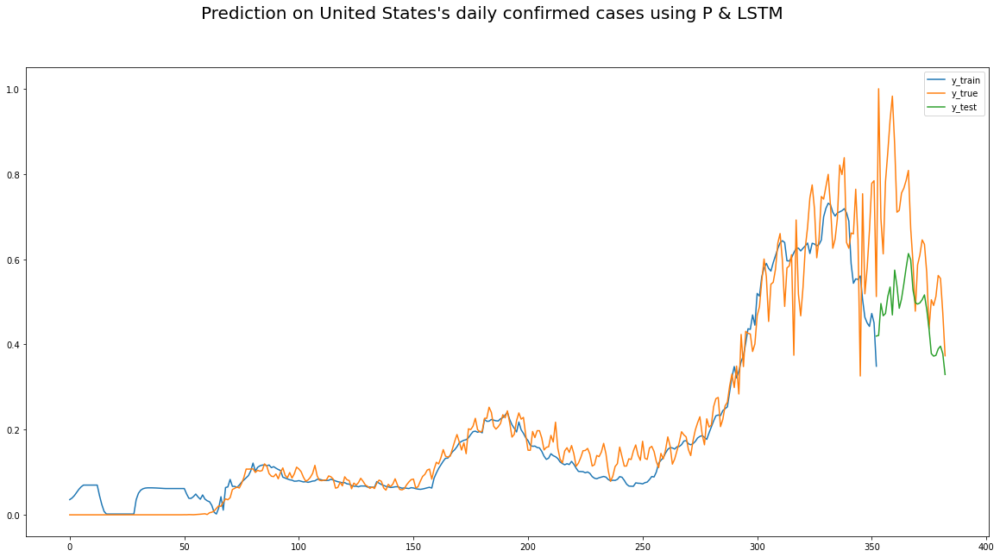

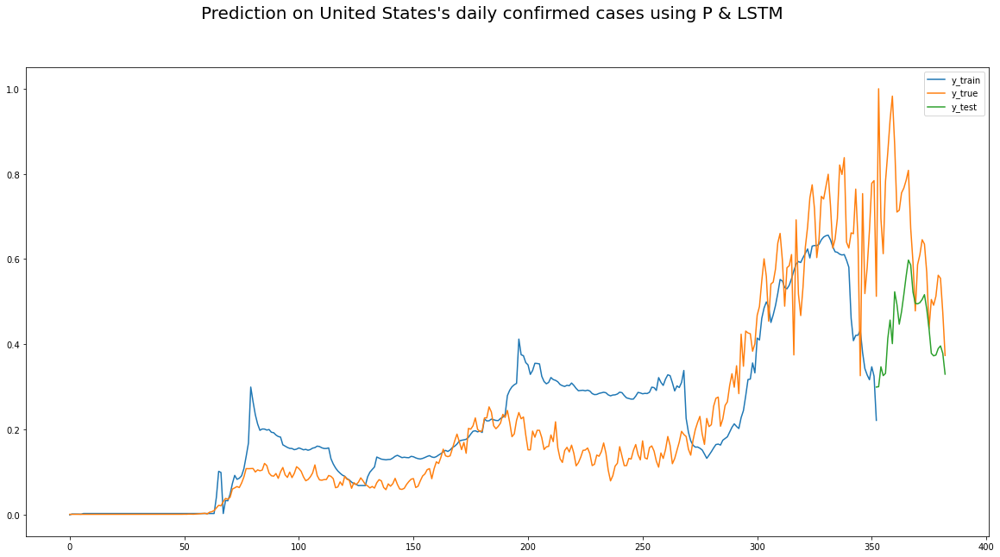

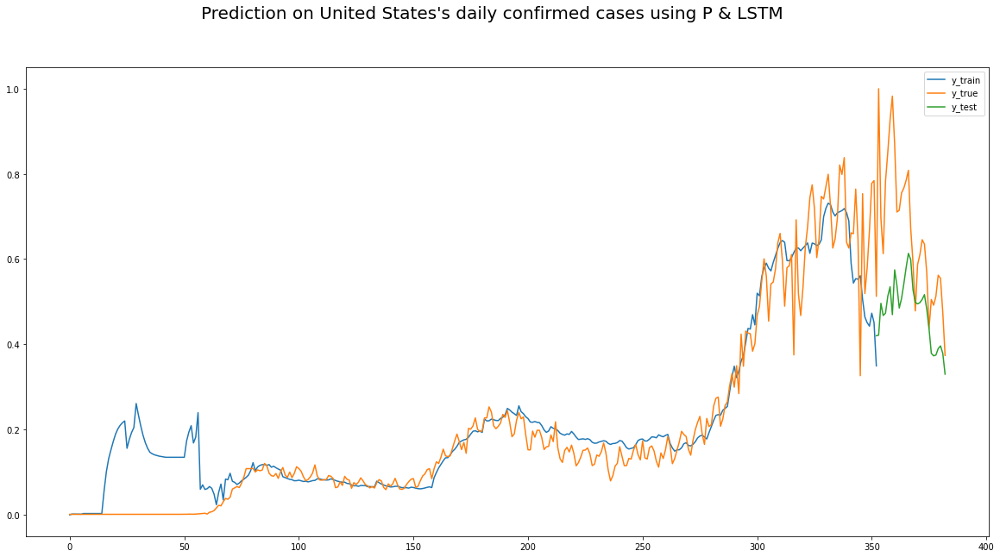

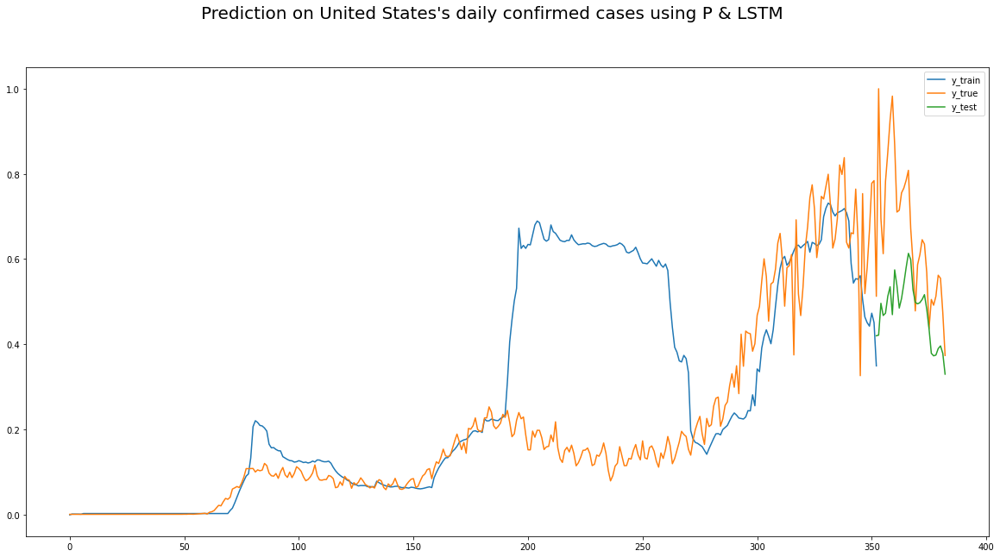

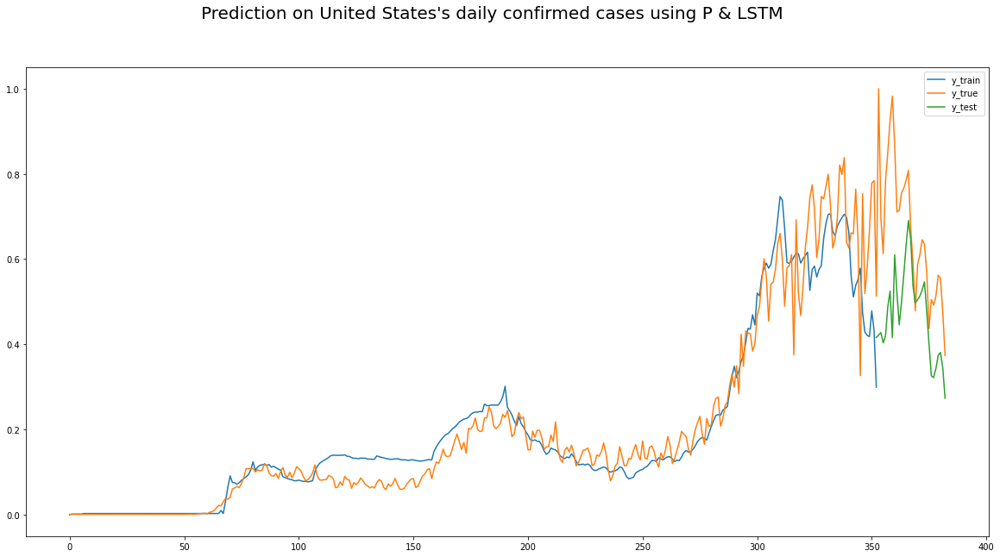

...

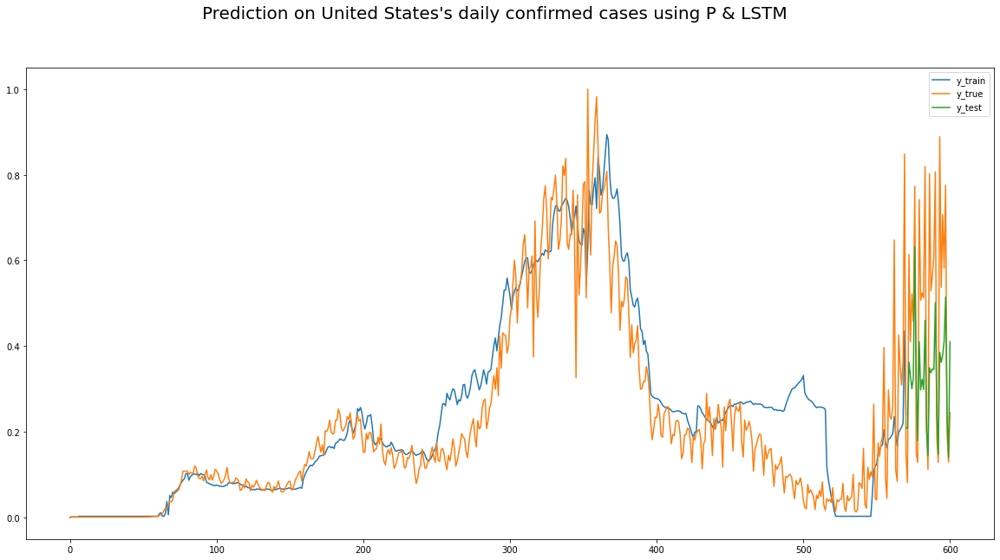

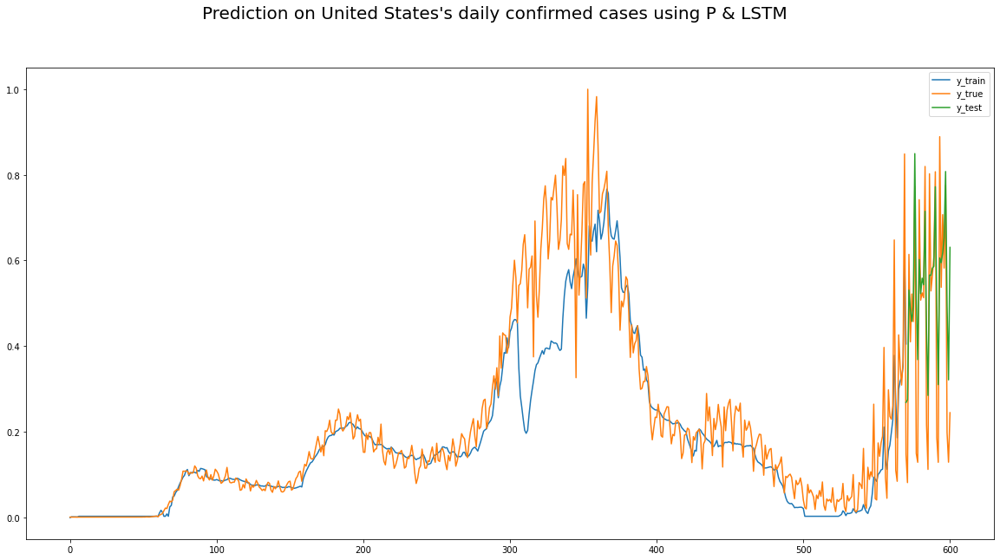

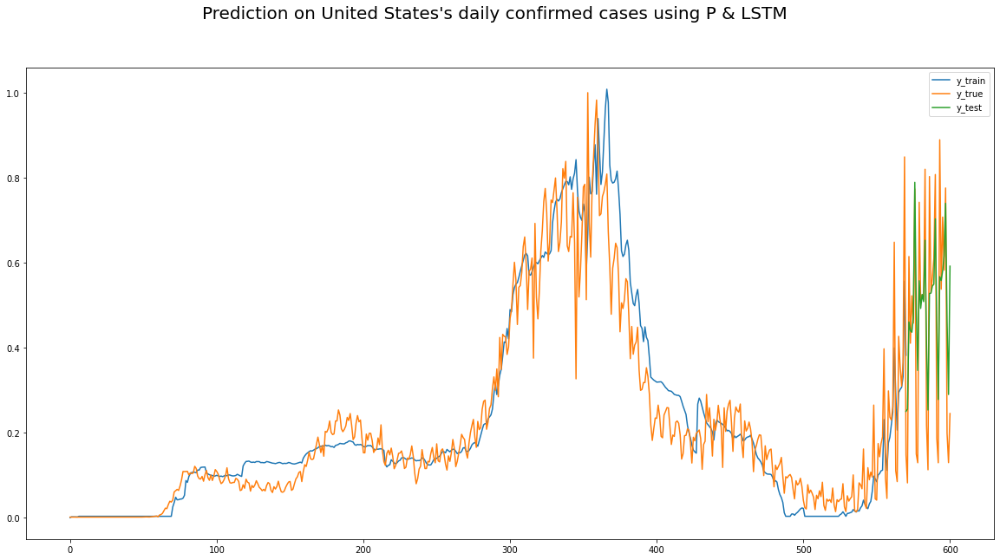

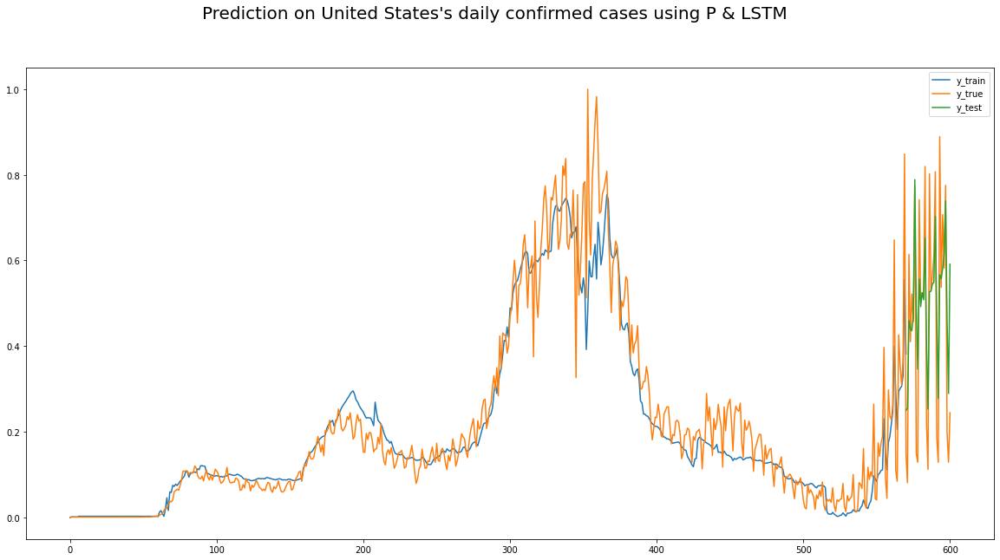

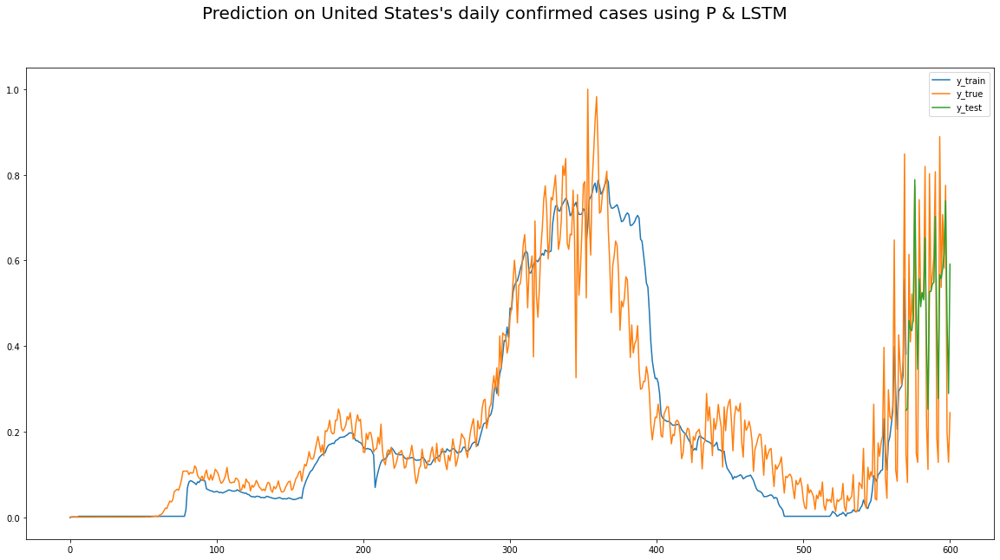

In [12]:
### Feature importance for the country each month
months = ['Jan', 'Feb', 'March', 'April', 'May', 'June', 'July', 'August', 'Sept']

for i in range(len(months)):

    tmp = df[pd.to_datetime(df.index, dayfirst=True) < dt(2021, i+2, 1)]
    
    x_train, x_test, y_train, y_test = data_handling(tmp, features, required_days, pred_days, test_size=30)
    y_pred_train = compress_to_2d(best_model.predict(x_train))
    y_pred_test = compress_to_2d(best_model.predict(x_test))
    y_true_train = compress_to_2d(y_train)
    y_true_test = compress_to_2d(y_test)

    mse = tf.keras.losses.MeanSquaredError()
    loss = mse(y_true_train, y_pred_train).numpy()
    val_loss = mse(y_true_test, y_pred_test).numpy()
    
    result2 = {}
    
    print("######", months[i], "#####")

    for j in range(len(policy)):
        
        target = policy[j]
        xx_train, xx_test, yy_train, yy_test = data_handling(tmp, features, required_days, pred_days, swap_col=target, test_size=30)
    
        exp_train = compress_to_2d(best_model.predict(xx_train))
        exp_test = compress_to_2d(best_model.predict(xx_test))
    
        draw_graph(exp_train, exp_test, y_true_train, y_true_test, required_days, pred_days, country, features_used, xx_train, algo)

        _loss = mse(y_true_train, exp_train).numpy()
        _val_loss = mse(y_true_test, exp_test).numpy()

        print("######", target, "#####")
        print("Changes in loss: {}".format(_loss-loss))
        print("Changes in Validation loss: {}".format(_val_loss-val_loss))

        result2[target] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]

    Changes = pd.DataFrame.from_dict(result2, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
    Changes.to_csv(os.path.join(logdir, "{}/{}_feat_importance_{}.csv".format(country, country, months[i])))

### Feature importance for the country
result2 = {}

for i in range(len(policy)):
    
    target = policy[i]
    x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days, swap_col=target)
        
    if algo == 'Attention':
        model = keras.Model.from_config(config)
    else:
        model = keras.Sequential.from_config(config)

    model.compile(optimizer=opt, loss=rmse)
    model.summary()
    
    kf = KFold()
    for train_index, test_index in kf.split(x_train):
        xx_train, xx_test = x_train[train_index], x_train[test_index]
        yy_train, yy_test = y_train[train_index], y_train[test_index]
        
        history = model.fit(xx_train, yy_train, shuffle=True,
                 validation_data=(xx_test, yy_test),
                 epochs=1000,
                 callbacks=[early_stopping, reduce_lr],
                 verbose=0)
    
    exp_train = compress_to_2d(model.predict(x_train))
    exp_test = compress_to_2d(model.predict(x_test))

    _loss = mse(y_true_train, exp_train).numpy()
    _val_loss = mse(y_true_test, exp_test).numpy()
    
    print("######", target, "#####")
    print("Changes in loss: {}".format(_loss-loss))
    print("Changes in Validation loss: {}".format(_val_loss-val_loss))
    
    result2[target] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]

Changes = pd.DataFrame.from_dict(result2, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
Changes.to_csv(os.path.join(logdir, "{}_feat_importance.csv".format(country)))

### Significance for best model
result = {}

tmp = policy.copy()

for i in range(len(policy)):
    
    dropped_feature = tmp.pop()
    features.remove(dropped_feature)
        
    x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
    if algo == 'Attention':
        model = keras.Model.from_config(config)
    else:
        model = keras.Sequential.from_config(config)
    
    model.summary()
    
    kf = KFold()
    for train_index, test_index in kf.split(x_train):
        xx_train, xx_test = x_train[train_index], x_train[test_index]
        yy_train, yy_test = y_train[train_index], y_train[test_index]

        history = model.fit(xx_train, yy_train, shuffle=True,
                 validation_data=(xx_test, yy_test),
                 epochs=1000,
                 callbacks=[early_stopping, reduce_lr],
                 verbose=0)
        
    exp_train = compress_to_2d(model.predict(x_train))
    exp_test = compress_to_2d(model.predict(x_test))

    _loss = mse(y_true_train, exp_train).numpy()
    _val_loss = mse(y_true_test, exp_test).numpy()
    
    print("######", dropped_feature, "#####")
    print("Changes in loss: {}".format(_loss-loss))
    print("Changes in Validation loss: {}".format(_val_loss-val_loss))
    
    result[dropped_feature] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]
    features.append(dropped_feature)

Changes = pd.DataFrame.from_dict(result, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
Changes.to_csv(os.path.join(logdir, "{}_significance.csv".format(country)))

In [13]:
#print(np.array(outputs[1], dtype=object).shape)